In [50]:
pip install pandas-profiling==2.7.1 

In [51]:
import pandas as pd
import numpy as np
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.model_selection import train_test_split , GridSearchCV
from sklearn.metrics import accuracy_score , confusion_matrix, roc_auc_score , roc_curve
from pandas_profiling import ProfileReport

In [52]:
df=pd.read_csv("winequality.csv",sep=';')

In [53]:
df.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5


In [54]:
profile=ProfileReport(df)

In [55]:
profile

Summarize dataset:   0%|          | 0/24 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [56]:
profile.to_widgets()

/usr/local/lib/python3.7/dist-packages/pandas_profiling/profile_report.py:361: UserWarning: Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60).As an alternative, you can use the HTML report. See the documentation for more information.
  "Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60)."


Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

In [57]:
profile.to_file('test.html')

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [58]:
x=df.drop(columns='quality')

In [59]:
y=df.quality

In [60]:
x

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
0,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4
1,7.8,0.880,0.00,2.6,0.098,25.0,67.0,0.99680,3.20,0.68,9.8
2,7.8,0.760,0.04,2.3,0.092,15.0,54.0,0.99700,3.26,0.65,9.8
3,11.2,0.280,0.56,1.9,0.075,17.0,60.0,0.99800,3.16,0.58,9.8
4,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4
...,...,...,...,...,...,...,...,...,...,...,...
1594,6.2,0.600,0.08,2.0,0.090,32.0,44.0,0.99490,3.45,0.58,10.5
1595,5.9,0.550,0.10,2.2,0.062,39.0,51.0,0.99512,3.52,0.76,11.2
1596,6.3,0.510,0.13,2.3,0.076,29.0,40.0,0.99574,3.42,0.75,11.0
1597,5.9,0.645,0.12,2.0,0.075,32.0,44.0,0.99547,3.57,0.71,10.2


In [61]:
y

0       5
1       5
2       5
3       6
4       5
       ..
1594    5
1595    6
1596    6
1597    5
1598    6
Name: quality, Length: 1599, dtype: int64

In [62]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.20,random_state=0)

In [63]:
x_train

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
642,9.9,0.540,0.45,2.3,0.071,16.0,40.0,0.99910,3.39,0.62,9.4
679,10.8,0.260,0.45,3.3,0.060,20.0,49.0,0.99720,3.13,0.54,9.6
473,9.9,0.350,0.55,2.1,0.062,5.0,14.0,0.99710,3.26,0.79,10.6
390,5.6,0.850,0.05,1.4,0.045,12.0,88.0,0.99240,3.56,0.82,12.9
1096,6.6,0.725,0.09,5.5,0.117,9.0,17.0,0.99655,3.35,0.49,10.8
...,...,...,...,...,...,...,...,...,...,...,...
763,9.3,0.655,0.26,2.0,0.096,5.0,35.0,0.99738,3.25,0.42,9.6
835,7.6,0.665,0.10,1.5,0.066,27.0,55.0,0.99655,3.39,0.51,9.3
1216,7.9,0.570,0.31,2.0,0.079,10.0,79.0,0.99677,3.29,0.69,9.5
559,13.0,0.470,0.49,4.3,0.085,6.0,47.0,1.00210,3.30,0.68,12.7


In [64]:
y_train

642     5
679     5
473     5
390     8
1096    6
       ..
763     5
835     5
1216    6
559     6
684     5
Name: quality, Length: 1279, dtype: int64

In [65]:
x_test

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
1109,10.8,0.470,0.43,2.10,0.171,27.0,66.0,0.99820,3.17,0.76,10.8
1032,8.1,0.820,0.00,4.10,0.095,5.0,14.0,0.99854,3.36,0.53,9.6
1002,9.1,0.290,0.33,2.05,0.063,13.0,27.0,0.99516,3.26,0.84,11.7
487,10.2,0.645,0.36,1.80,0.053,5.0,14.0,0.99820,3.17,0.42,10.0
979,12.2,0.450,0.49,1.40,0.075,3.0,6.0,0.99690,3.13,0.63,10.4
...,...,...,...,...,...,...,...,...,...,...,...
794,10.1,0.270,0.54,2.30,0.065,7.0,26.0,0.99531,3.17,0.53,12.5
813,6.9,0.390,0.24,2.10,0.102,4.0,7.0,0.99462,3.44,0.58,11.4
1322,9.1,0.340,0.42,1.80,0.058,9.0,18.0,0.99392,3.18,0.55,11.4
704,9.1,0.765,0.04,1.60,0.078,4.0,14.0,0.99800,3.29,0.54,9.7


In [66]:
y_test

1109    6
1032    5
1002    7
487     6
979     5
       ..
794     6
813     4
1322    5
704     4
1023    6
Name: quality, Length: 320, dtype: int64

In [67]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.neighbors import KNeighborsClassifier

In [68]:
bag_dt = BaggingClassifier(DecisionTreeClassifier() , n_estimators=100)#n_estimators--no.of models in particular bag

In [69]:
bag_dt.fit(x_train,y_train)

BaggingClassifier(base_estimator=DecisionTreeClassifier(), n_estimators=100)

In [70]:
bag_dt.predict(x_test)

array([6, 5, 7, 5, 5, 6, 5, 6, 5, 5, 5, 5, 6, 6, 6, 7, 7, 5, 5, 6, 6, 5,
       6, 7, 5, 5, 5, 7, 5, 6, 6, 6, 6, 5, 7, 7, 5, 6, 6, 6, 5, 6, 6, 7,
       6, 5, 5, 6, 5, 6, 5, 5, 6, 6, 6, 5, 5, 5, 7, 5, 5, 6, 6, 6, 5, 6,
       5, 5, 7, 6, 5, 5, 5, 5, 6, 6, 5, 5, 5, 7, 6, 5, 6, 6, 6, 5, 6, 5,
       5, 5, 5, 6, 6, 5, 7, 5, 6, 5, 5, 5, 7, 6, 6, 6, 5, 5, 5, 5, 6, 5,
       6, 5, 8, 5, 6, 6, 6, 7, 6, 6, 5, 6, 5, 5, 6, 7, 5, 5, 6, 6, 5, 6,
       6, 5, 6, 5, 6, 5, 6, 5, 6, 5, 5, 5, 5, 6, 8, 6, 5, 5, 6, 5, 5, 6,
       6, 6, 6, 5, 6, 6, 6, 6, 7, 5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 7, 5, 6,
       7, 7, 7, 5, 5, 7, 6, 6, 7, 5, 6, 6, 5, 5, 6, 5, 5, 6, 5, 5, 5, 5,
       5, 5, 5, 6, 6, 6, 5, 5, 5, 6, 7, 6, 6, 6, 5, 7, 5, 6, 5, 6, 6, 5,
       5, 6, 6, 5, 6, 6, 6, 6, 6, 6, 5, 6, 5, 5, 7, 6, 6, 7, 7, 6, 5, 6,
       5, 5, 6, 5, 5, 5, 5, 6, 5, 5, 5, 6, 5, 6, 5, 5, 5, 7, 5, 6, 5, 6,
       5, 5, 5, 5, 5, 6, 5, 5, 5, 5, 6, 6, 6, 6, 6, 7, 5, 7, 5, 6, 6, 5,
       5, 5, 7, 6, 5, 5, 6, 6, 5, 6, 6, 5, 5, 5, 6,

In [71]:
bag_dt.base_estimator_

DecisionTreeClassifier()

In [72]:
bag_knn=BaggingClassifier(KNeighborsClassifier(6),n_estimators=10)

In [73]:
bag_knn.fit(x_train,y_train)

BaggingClassifier(base_estimator=KNeighborsClassifier(n_neighbors=6))

In [74]:
bag_knn.predict(x_test)

array([5, 5, 7, 6, 6, 5, 6, 6, 6, 6, 5, 6, 5, 5, 5, 6, 7, 6, 7, 6, 6, 6,
       6, 5, 6, 5, 5, 6, 5, 6, 6, 6, 6, 5, 6, 7, 5, 6, 6, 6, 5, 7, 6, 7,
       6, 6, 5, 6, 6, 5, 6, 5, 5, 7, 6, 5, 5, 6, 7, 5, 5, 6, 6, 5, 5, 5,
       5, 5, 7, 7, 5, 5, 6, 5, 6, 6, 5, 5, 5, 6, 5, 5, 4, 6, 5, 5, 5, 5,
       6, 5, 5, 5, 5, 6, 4, 5, 5, 6, 6, 5, 7, 5, 6, 6, 6, 6, 6, 7, 6, 5,
       6, 5, 6, 6, 5, 6, 5, 7, 7, 6, 5, 7, 6, 5, 5, 5, 5, 5, 5, 7, 5, 5,
       5, 6, 6, 5, 6, 5, 6, 6, 6, 5, 5, 6, 5, 6, 6, 7, 6, 6, 5, 5, 7, 6,
       5, 6, 6, 6, 6, 6, 5, 6, 5, 6, 6, 5, 6, 5, 6, 5, 5, 7, 6, 7, 4, 5,
       7, 7, 7, 5, 5, 6, 6, 6, 7, 5, 6, 6, 5, 6, 5, 5, 5, 5, 5, 5, 5, 5,
       5, 5, 6, 6, 6, 6, 5, 5, 6, 6, 6, 5, 5, 5, 5, 5, 5, 5, 5, 6, 5, 5,
       5, 5, 6, 6, 6, 6, 5, 5, 5, 5, 5, 6, 5, 5, 6, 6, 7, 6, 7, 6, 6, 6,
       6, 6, 5, 5, 5, 5, 5, 5, 5, 6, 5, 6, 5, 5, 5, 6, 5, 7, 5, 6, 6, 5,
       5, 5, 6, 5, 6, 5, 5, 5, 6, 5, 6, 6, 7, 6, 6, 7, 6, 6, 5, 5, 5, 5,
       6, 5, 6, 6, 5, 5, 6, 6, 5, 6, 5, 5, 5, 5, 6,

In [75]:
rf=RandomForestClassifier(n_estimators=5)
rf.fit(x_train,y_train)


RandomForestClassifier(n_estimators=5)

In [76]:
rf.predict(x_test)

array([5, 5, 7, 5, 5, 6, 5, 6, 5, 5, 5, 5, 6, 6, 5, 6, 7, 5, 5, 6, 6, 6,
       6, 5, 5, 5, 5, 6, 5, 6, 5, 7, 6, 5, 7, 6, 5, 6, 5, 6, 5, 6, 6, 7,
       5, 6, 5, 6, 5, 5, 5, 5, 6, 6, 6, 5, 5, 5, 7, 5, 5, 5, 6, 5, 5, 6,
       5, 5, 7, 6, 5, 6, 5, 5, 6, 6, 5, 5, 5, 7, 5, 5, 6, 6, 6, 6, 5, 5,
       5, 5, 5, 5, 7, 5, 7, 5, 7, 5, 5, 5, 7, 7, 6, 7, 5, 5, 5, 5, 6, 5,
       6, 5, 8, 5, 6, 6, 6, 7, 5, 6, 5, 5, 5, 5, 6, 5, 5, 5, 5, 6, 6, 6,
       6, 6, 6, 5, 6, 5, 6, 5, 6, 5, 5, 5, 5, 6, 8, 6, 5, 5, 6, 5, 5, 6,
       6, 6, 5, 5, 6, 6, 5, 5, 7, 5, 5, 5, 6, 6, 6, 6, 6, 5, 4, 7, 5, 6,
       7, 7, 7, 5, 5, 7, 6, 6, 6, 5, 6, 6, 5, 6, 6, 6, 5, 6, 5, 5, 5, 5,
       5, 5, 5, 6, 6, 5, 5, 5, 5, 6, 6, 6, 5, 6, 5, 6, 5, 6, 5, 6, 6, 5,
       5, 6, 7, 5, 5, 6, 6, 7, 6, 5, 5, 6, 6, 5, 6, 6, 5, 7, 7, 6, 5, 6,
       6, 5, 6, 5, 5, 5, 5, 6, 5, 6, 5, 5, 5, 5, 5, 5, 5, 7, 5, 6, 6, 6,
       6, 5, 5, 5, 6, 6, 5, 5, 6, 6, 7, 6, 6, 6, 5, 7, 5, 6, 5, 6, 6, 5,
       5, 5, 7, 6, 5, 5, 6, 5, 5, 6, 6, 5, 5, 5, 6,

In [77]:
rf.score(x_test,y_test)

0.659375

In [78]:
bag_dt.score(x_test,y_test)

0.725

In [79]:
bag_knn.score(x_test,y_test)

0.503125

In [80]:
rf.estimators_

[DecisionTreeClassifier(max_features='auto', random_state=1609467044),
 DecisionTreeClassifier(max_features='auto', random_state=2114323235),
 DecisionTreeClassifier(max_features='auto', random_state=980279926),
 DecisionTreeClassifier(max_features='auto', random_state=1946893617),
 DecisionTreeClassifier(max_features='auto', random_state=2103726650)]

In [81]:
import  matplotlib.pyplot as plt
from sklearn import tree
%matplotlib inline 

[Text(502.2195636642676, 1058.5894736842106, 'X[9] <= 0.585\ngini = 0.654\nsamples = 811\nvalue = [7, 30, 525, 498, 202, 17]'),
 Text(206.06075359864522, 1001.3684210526317, 'X[10] <= 10.15\ngini = 0.538\nsamples = 304\nvalue = [2, 17, 285, 138, 26, 0]'),
 Text(84.45596951735817, 944.1473684210526, 'X[6] <= 26.5\ngini = 0.375\nsamples = 194\nvalue = [1, 8, 229, 61, 1, 0]'),
 Text(29.29381879762913, 886.9263157894737, 'X[1] <= 0.65\ngini = 0.143\nsamples = 43\nvalue = [0, 1, 61, 3, 1, 0]'),
 Text(17.00931414055885, 829.7052631578947, 'X[9] <= 0.435\ngini = 0.202\nsamples = 22\nvalue = [0, 0, 32, 3, 1, 0]'),
 Text(7.55969517358171, 772.4842105263158, 'X[6] <= 20.0\ngini = 0.5\nsamples = 2\nvalue = [0, 0, 1, 1, 0, 0]'),
 Text(3.779847586790855, 715.2631578947369, 'gini = 0.0\nsamples = 1\nvalue = [0, 0, 1, 0, 0, 0]'),
 Text(11.339542760372566, 715.2631578947369, 'gini = 0.0\nsamples = 1\nvalue = [0, 0, 0, 1, 0, 0]'),
 Text(26.458933107535987, 772.4842105263158, 'X[5] <= 8.5\ngini = 0.164\

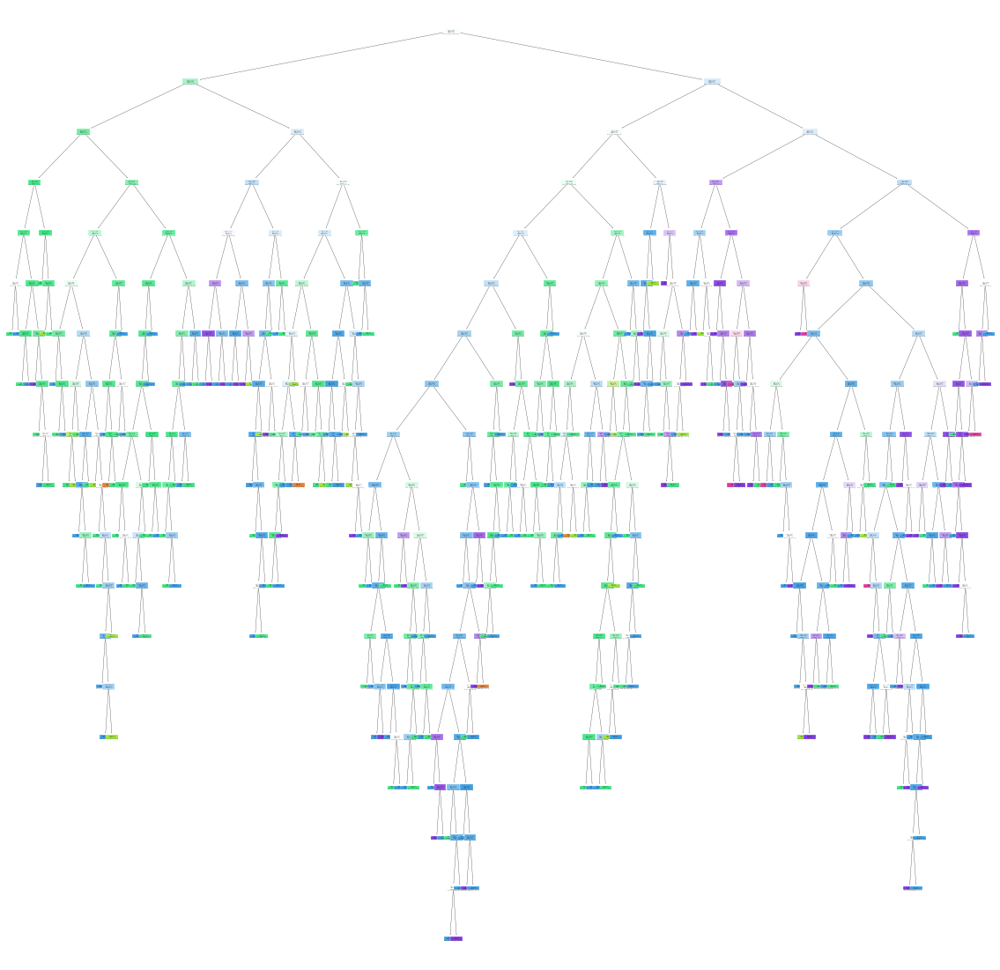

In [82]:
plt.figure(figsize=(20,20))
tree.plot_tree(rf.estimators_[0],filled=True)

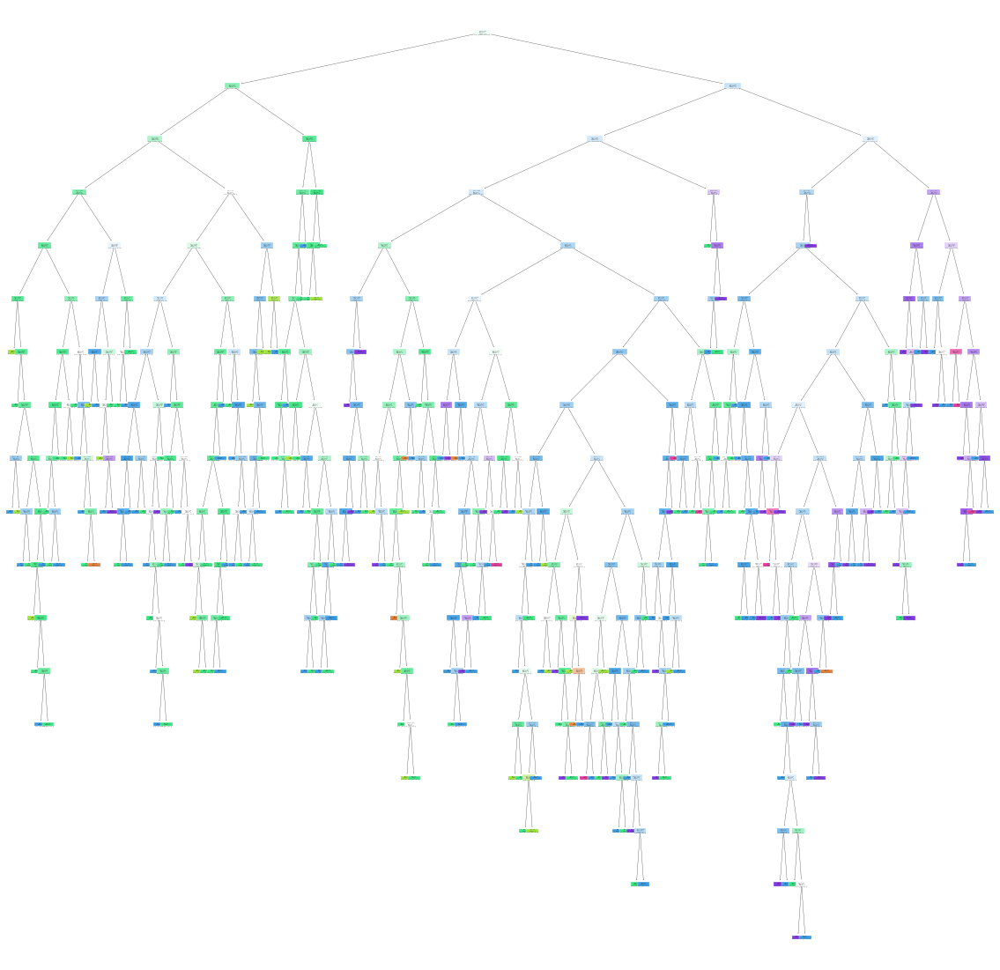

In [83]:
plt.figure(figsize = (20,20))
for i in range(len(rf.estimators_)):
    tree.plot_tree(rf.estimators_[i] , filled = True )

In [84]:
grid_pram={
    "n_estimators":[5,10,50,100,120,150],
    "criterion":['gini','entropy'],
    "max_depth":range(10),
    "min_samples_leaf":range(10)
}

In [85]:
rf = RandomForestClassifier(n_estimators=5)

In [86]:
grid_serach_rf = GridSearchCV(param_grid= grid_pram, cv = 10 , n_jobs=6,verbose=1 ,estimator = rf)

In [87]:
grid_serach_rf

GridSearchCV(cv=10, estimator=RandomForestClassifier(n_estimators=5), n_jobs=6,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': range(0, 10),
                         'min_samples_leaf': range(0, 10),
                         'n_estimators': [5, 10, 50, 100, 120, 150]},
             verbose=1)

In [49]:
grid_serach_rf.fit(x_train,y_train)

Fitting 10 folds for each of 1200 candidates, totalling 12000 fits


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_split.py:680: UserWarning: The least populated class in y has only 8 members, which is less than n_splits=10.
  UserWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
2280 fits failed out of a total of 12000.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1200 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 681, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py", line 459, in fit
    for i, t in enumerate(tr

GridSearchCV(cv=10, estimator=RandomForestClassifier(n_estimators=5), n_jobs=6,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': range(0, 10),
                         'min_samples_leaf': range(0, 10),
                         'n_estimators': [5, 10, 50, 100, 120, 150]},
             verbose=1)

In [88]:
rf_new = RandomForestClassifier(criterion='entropy' , max_depth=9 , min_samples_leaf= 1 , n_estimators=120)

In [89]:
rf_new.fit(x_train,y_train)

RandomForestClassifier(criterion='entropy', max_depth=9, n_estimators=120)

In [90]:
rf_new.score(x_test,y_test)

0.703125

[Text(563.047697368421, 1032.8400000000001, 'X[2] <= 0.275\nentropy = 1.726\nsamples = 804\nvalue = [8, 40, 533, 505, 179, 14]'),
 Text(304.6973684210526, 924.1200000000001, 'X[1] <= 0.808\nentropy = 1.619\nsamples = 432\nvalue = [7, 31, 341, 273, 49, 5]'),
 Text(144.8397129186603, 815.4000000000001, 'X[9] <= 0.555\nentropy = 1.457\nsamples = 385\nvalue = [0, 11, 306, 261, 46, 4]'),
 Text(47.723684210526315, 706.6800000000001, 'X[1] <= 0.455\nentropy = 1.027\nsamples = 132\nvalue = [0, 6, 148, 60, 0, 0]'),
 Text(16.019138755980862, 597.96, 'X[10] <= 9.7\nentropy = 0.742\nsamples = 10\nvalue = [0, 0, 4, 15, 0, 0]'),
 Text(10.679425837320574, 489.24, 'X[0] <= 6.9\nentropy = 0.722\nsamples = 3\nvalue = [0, 0, 4, 1, 0, 0]'),
 Text(5.339712918660287, 380.5200000000001, 'entropy = 0.0\nsamples = 1\nvalue = [0, 0, 0, 1, 0, 0]'),
 Text(16.019138755980862, 380.5200000000001, 'entropy = 0.0\nsamples = 2\nvalue = [0, 0, 4, 0, 0, 0]'),
 Text(21.358851674641148, 489.24, 'entropy = 0.0\nsamples = 7\

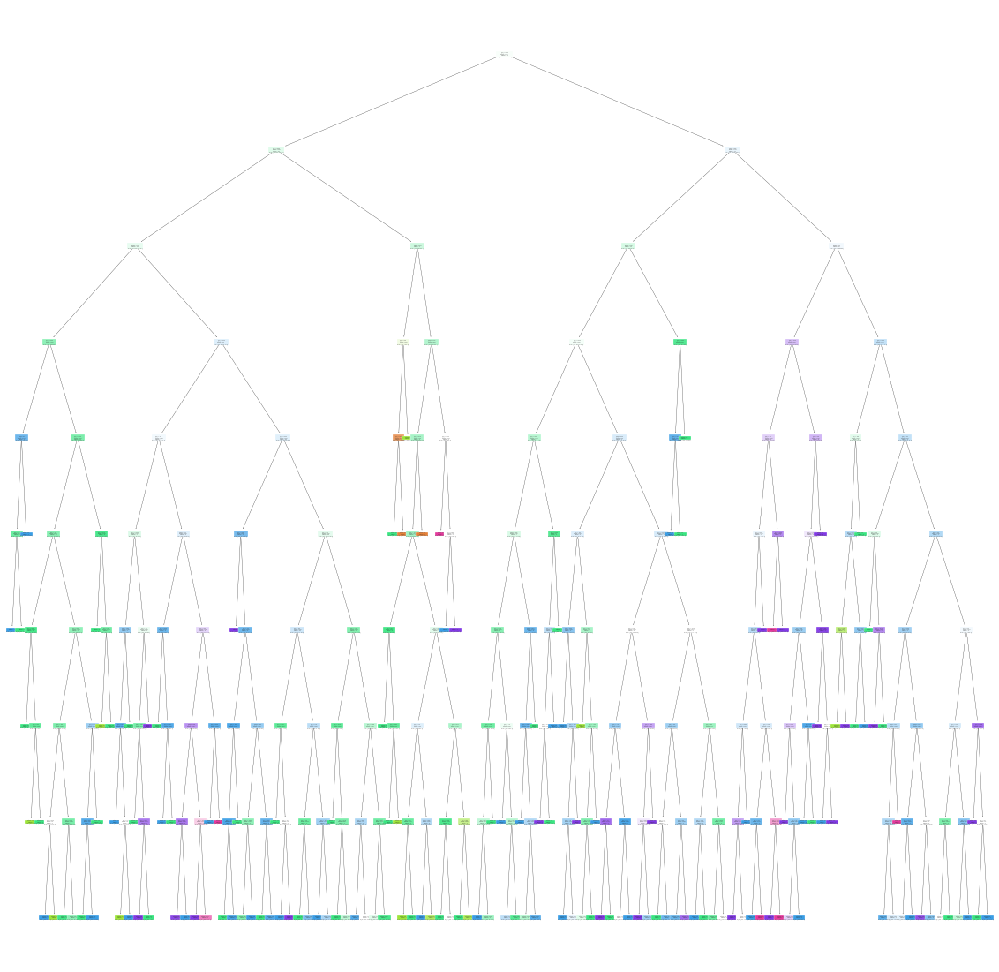

In [91]:
plt.figure(figsize = (20,20))
tree.plot_tree(rf_new.estimators_[0] , filled = True )